In [1]:
import folium
import pandas as pd

In [2]:
DATA_PATH = "data"

In [6]:
df_card_1 = pd.read_csv(f"{DATA_PATH}/TOTAL_BC1_MM_CCND_CUST_CRTR_CCND_CSPT_SGG_MG.csv", encoding='cp949')
df_card_2 = pd.read_csv(f"{DATA_PATH}/TOTAL_BC1_MM_CCND_CUST_CRTR_CCND_EXCL_LC_CSPT_SGG_MG.csv", encoding='cp949')
df_card_3 = pd.read_csv(f"{DATA_PATH}/TOTAL_BC1_MM_CCND_EXCL_RSDT_CRTR_CCND_CSPT_SGG_MG.csv", encoding = 'cp949')
df_card_4 = pd.read_csv(f"{DATA_PATH}/TOTAL_BC1_MM_LC_CRTR_TOBIZ_SLS_SZ_MG.csv", encoding = 'cp949')

In [14]:
import matplotlib.font_manager as fm

plt.rc('font', family='Malgun Gothic')  # 맑은 고딕 폰트를 사용
plt.rcParams['axes.unicode_minus'] = False

충남 고객기준 충남 소비 현황(BC카드자료기준)

In [15]:
df_card_1

,기준연월,시군구명,전체이용건수,전체이용금액
0,201901,계룡시,52835,1608962707
1,201901,공주시,161138,6820958298
2,201901,금산군,54561,2365397628
3,201901,논산시,209979,9132759474
4,201901,당진시,406899,15952303417
...,...,...,...,...
923,202310,천안시 동남구,766141,26958920481
924,202310,천안시 서북구,1230166,41226331503
925,202310,청양군,33583,2367998642
926,202310,태안군,76289,4218484261


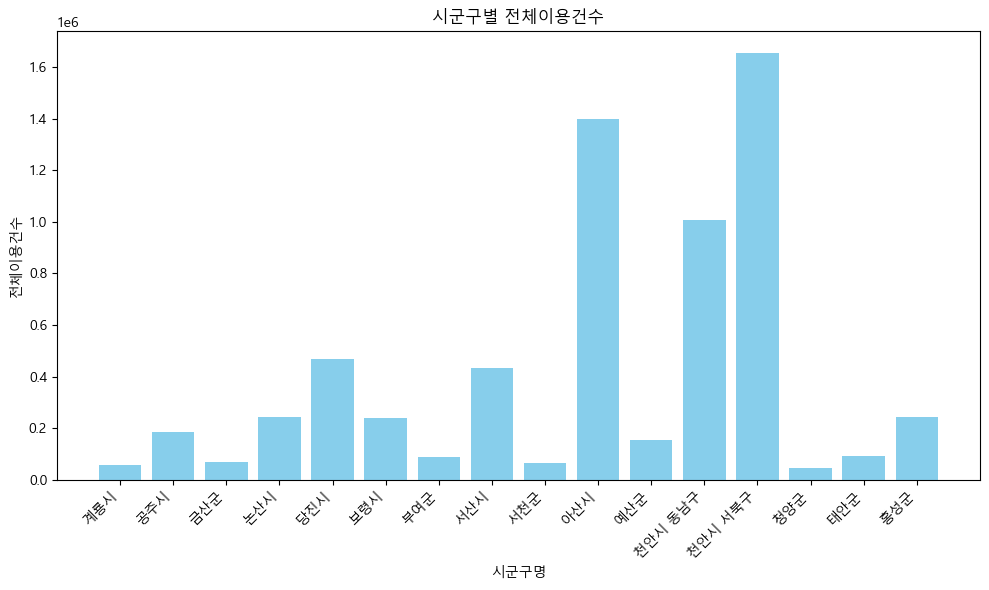

In [16]:
import matplotlib.pyplot as plt

# 시군구별 전체이용건수 시각화
plt.figure(figsize=(10, 6))
plt.bar(df_card_1['시군구명'], df_card_1['전체이용건수'], color='skyblue')
plt.xlabel('시군구명')
plt.ylabel('전체이용건수')
plt.title('시군구별 전체이용건수')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

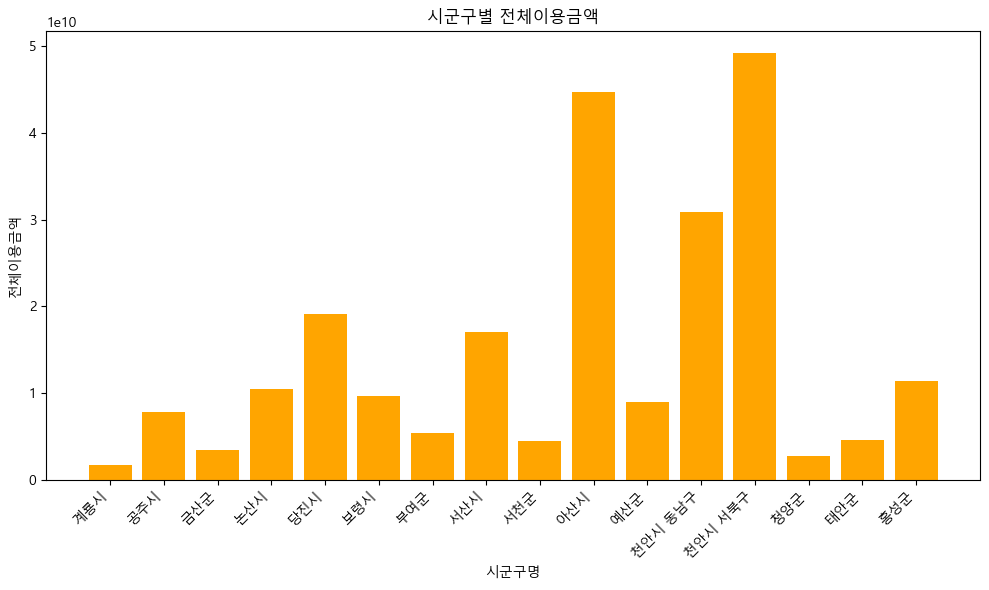

In [17]:
# 시군구별 전체이용금액 시각화
plt.figure(figsize=(10, 6))
plt.bar(df_card_1['시군구명'], df_card_1['전체이용금액'], color='orange')
plt.xlabel('시군구명')
plt.ylabel('전체이용금액')
plt.title('시군구별 전체이용금액')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

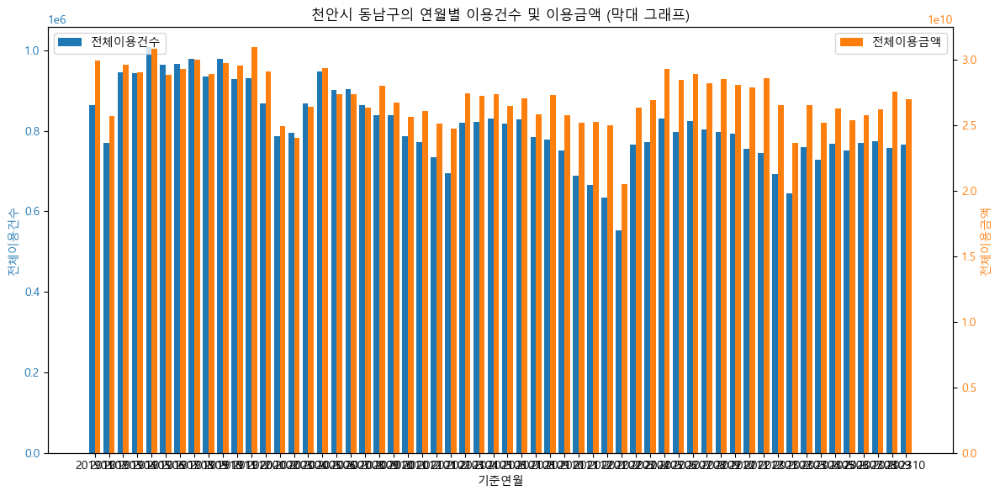

In [21]:
import numpy as np

region_name = '천안시 동남구'
df_region = df_card_1[df_card_1['시군구명'] == region_name]

# 연월별 이용건수 및 이용금액 시각화
fig, ax1 = plt.subplots(figsize=(12, 6))

# x축은 '기준연월'
x = np.arange(len(df_region['기준연월']))  # 위치를 설정하기 위해 numpy 배열 사용

# 첫 번째 y축 (이용건수) 막대 그래프
color = 'tab:blue'
ax1.set_xlabel('기준연월')
ax1.set_ylabel('전체이용건수', color=color)
bars1 = ax1.bar(x - 0.2, df_region['전체이용건수'], width=0.4, color=color, label='전체이용건수')
ax1.tick_params(axis='y', labelcolor=color)

# 두 번째 y축 (이용금액) 막대 그래프
ax2 = ax1.twinx()
color = 'tab:orange'
ax2.set_ylabel('전체이용금액', color=color)
bars2 = ax2.bar(x + 0.2, df_region['전체이용금액'], width=0.4, color=color, label='전체이용금액')
ax2.tick_params(axis='y', labelcolor=color)

# x축 레이블을 기준연월로 설정
ax1.set_xticks(x)
ax1.set_xticklabels(df_region['기준연월'])

# 그래프 제목 및 레이아웃 설정
plt.title(f'{region_name}의 연월별 이용건수 및 이용금액 (막대 그래프)')
fig.tight_layout()

# 범례 추가
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()

C:\Users\admin\AppData\Local\Temp\ipykernel_17112\4011053731.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_region['기준연월'] = df_region['기준연월'].astype(str)
C:\Users\admin\AppData\Local\Temp\ipykernel_17112\4011053731.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_region['년도'] = df_region['기준연월'].str[:4]


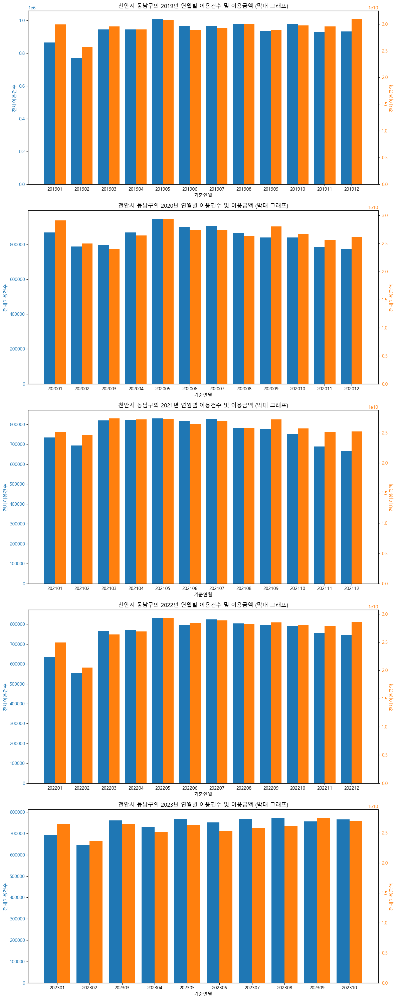

In [25]:
region_name = '천안시 동남구'
df_region = df_card_1[df_card_1['시군구명'] == region_name]

# '기준연월'을 문자열로 변환
df_region['기준연월'] = df_region['기준연월'].astype(str)

# '기준연월'에서 연도를 추출하여 '년도' 컬럼 생성
df_region['년도'] = df_region['기준연월'].str[:4]

# 연도 리스트
years = ['2019', '2020', '2021', '2022', '2023']

# 연도별 시각화
fig, axs = plt.subplots(len(years), 1, figsize=(12, len(years) * 6))

for i, year in enumerate(years):
    df_year = df_region[df_region['년도'] == year]
    x = np.arange(len(df_year['기준연월']))
    
    # 첫 번째 y축 (이용건수) 막대 그래프
    color = 'tab:blue'
    axs[i].set_xlabel('기준연월')
    axs[i].set_ylabel('전체이용건수', color=color)
    bars1 = axs[i].bar(x - 0.2, df_year['전체이용건수'], width=0.4, color=color, label='전체이용건수')
    axs[i].tick_params(axis='y', labelcolor=color)
    
    # 두 번째 y축 (이용금액) 막대 그래프
    ax2 = axs[i].twinx()
    color = 'tab:orange'
    ax2.set_ylabel('전체이용금액', color=color)
    bars2 = ax2.bar(x + 0.2, df_year['전체이용금액'], width=0.4, color=color, label='전체이용금액')
    ax2.tick_params(axis='y', labelcolor=color)
    
    # x축 레이블을 기준연월로 설정
    axs[i].set_xticks(x)
    axs[i].set_xticklabels(df_year['기준연월'])
    
    # 그래프 제목 및 레이아웃 설정
    axs[i].set_title(f'{region_name}의 {year}년 연월별 이용건수 및 이용금액 (막대 그래프)')
    fig.tight_layout()

plt.show()

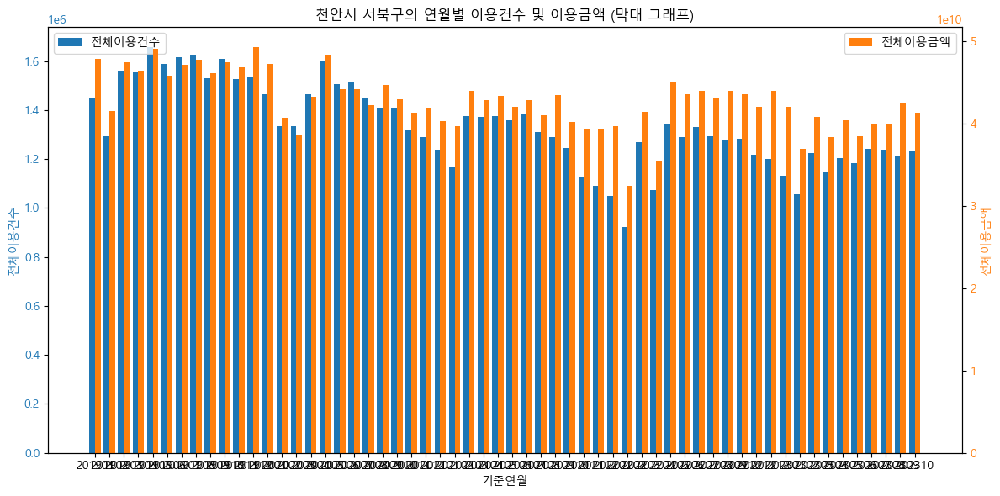

In [22]:
region_name = '천안시 서북구'
df_region = df_card_1[df_card_1['시군구명'] == region_name]

# 연월별 이용건수 및 이용금액 시각화
fig, ax1 = plt.subplots(figsize=(12, 6))

# x축은 '기준연월'
x = np.arange(len(df_region['기준연월']))  # 위치를 설정하기 위해 numpy 배열 사용

# 첫 번째 y축 (이용건수) 막대 그래프
color = 'tab:blue'
ax1.set_xlabel('기준연월')
ax1.set_ylabel('전체이용건수', color=color)
bars1 = ax1.bar(x - 0.2, df_region['전체이용건수'], width=0.4, color=color, label='전체이용건수')
ax1.tick_params(axis='y', labelcolor=color)

# 두 번째 y축 (이용금액) 막대 그래프
ax2 = ax1.twinx()
color = 'tab:orange'
ax2.set_ylabel('전체이용금액', color=color)
bars2 = ax2.bar(x + 0.2, df_region['전체이용금액'], width=0.4, color=color, label='전체이용금액')
ax2.tick_params(axis='y', labelcolor=color)

# x축 레이블을 기준연월로 설정
ax1.set_xticks(x)
ax1.set_xticklabels(df_region['기준연월'])

# 그래프 제목 및 레이아웃 설정
plt.title(f'{region_name}의 연월별 이용건수 및 이용금액 (막대 그래프)')
fig.tight_layout()

# 범례 추가
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()

C:\Users\admin\AppData\Local\Temp\ipykernel_17112\3585607473.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_region['기준연월'] = df_region['기준연월'].astype(str)
C:\Users\admin\AppData\Local\Temp\ipykernel_17112\3585607473.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_region['년도'] = df_region['기준연월'].str[:4]


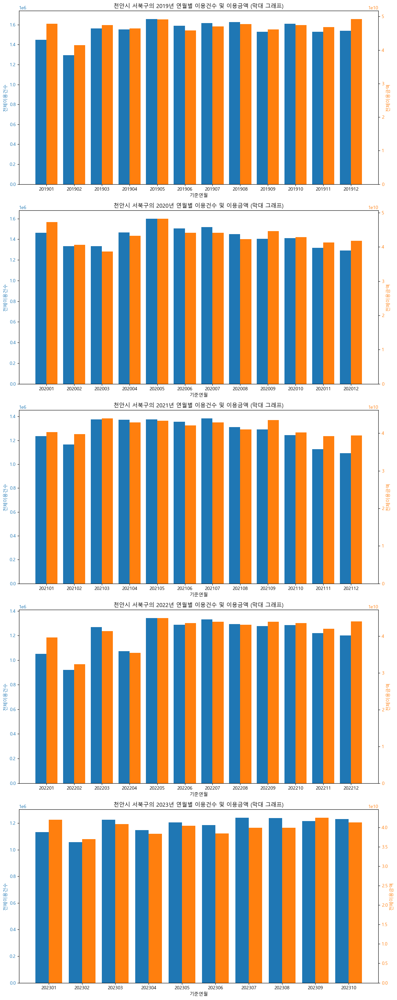

In [24]:
region_name = '천안시 서북구'
df_region = df_card_1[df_card_1['시군구명'] == region_name]

# '기준연월'을 문자열로 변환
df_region['기준연월'] = df_region['기준연월'].astype(str)

# '기준연월'에서 연도를 추출하여 '년도' 컬럼 생성
df_region['년도'] = df_region['기준연월'].str[:4]

# 연도 리스트
years = ['2019', '2020', '2021', '2022', '2023']

# 연도별 시각화
fig, axs = plt.subplots(len(years), 1, figsize=(12, len(years) * 6))

for i, year in enumerate(years):
    df_year = df_region[df_region['년도'] == year]
    x = np.arange(len(df_year['기준연월']))
    
    # 첫 번째 y축 (이용건수) 막대 그래프
    color = 'tab:blue'
    axs[i].set_xlabel('기준연월')
    axs[i].set_ylabel('전체이용건수', color=color)
    bars1 = axs[i].bar(x - 0.2, df_year['전체이용건수'], width=0.4, color=color, label='전체이용건수')
    axs[i].tick_params(axis='y', labelcolor=color)
    
    # 두 번째 y축 (이용금액) 막대 그래프
    ax2 = axs[i].twinx()
    color = 'tab:orange'
    ax2.set_ylabel('전체이용금액', color=color)
    bars2 = ax2.bar(x + 0.2, df_year['전체이용금액'], width=0.4, color=color, label='전체이용금액')
    ax2.tick_params(axis='y', labelcolor=color)
    
    # x축 레이블을 기준연월로 설정
    axs[i].set_xticks(x)
    axs[i].set_xticklabels(df_year['기준연월'])
    
    # 그래프 제목 및 레이아웃 설정
    axs[i].set_title(f'{region_name}의 {year}년 연월별 이용건수 및 이용금액 (막대 그래프)')
    fig.tight_layout()

plt.show()

충남 고객기준 충남외 소비 현황(BC카드자료기준)

In [8]:
df_card_2

,기준연월,시군구명,가맹점시군구명,전체이용건수,전체이용금액
0,201901,계룡시,가평군,40,1458380
1,201901,계룡시,강서구,581,45162061
2,201901,계룡시,경산시,95,4489838
3,201901,계룡시,구로구,1920,74014538
4,201901,계룡시,군산시,222,6897790
...,...,...,...,...,...
182585,202310,홍성군,청주시 흥덕구,277,8477880
182586,202310,홍성군,포항시 남구,22,744570
182587,202310,홍성군,함안군,62,5684833
182588,202310,홍성군,함양군,32,1412710


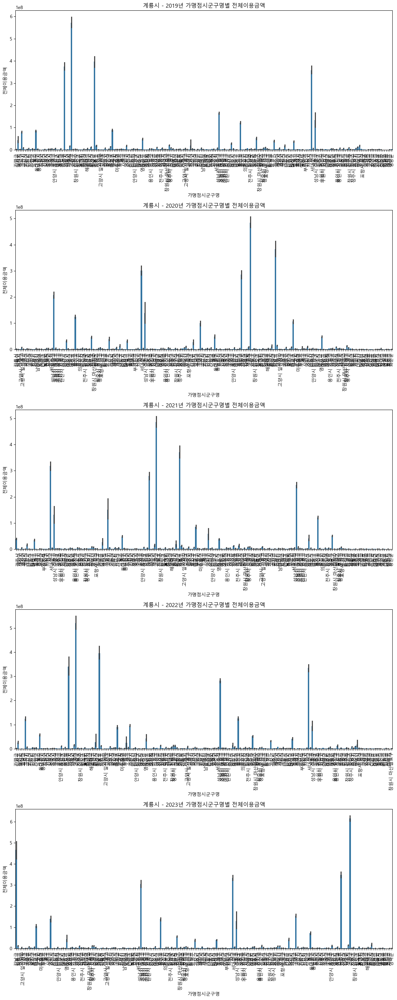

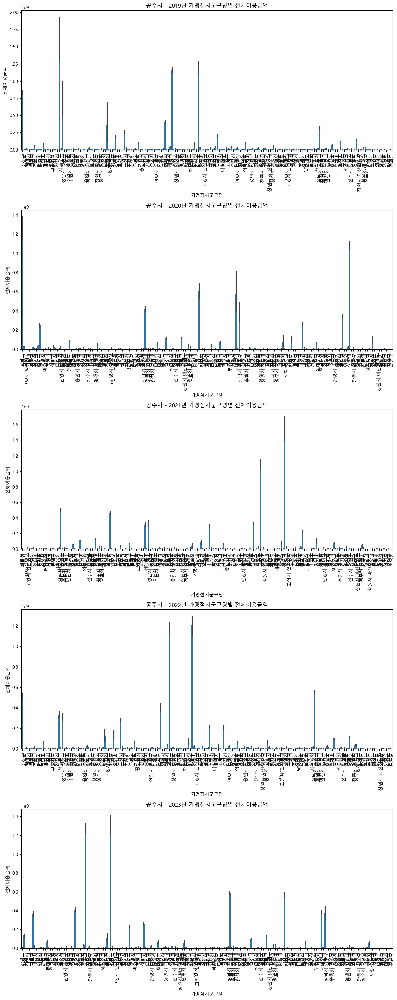

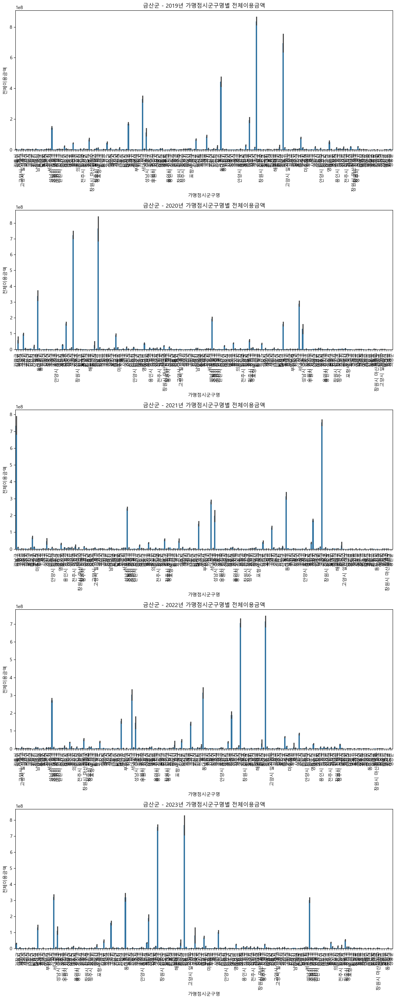

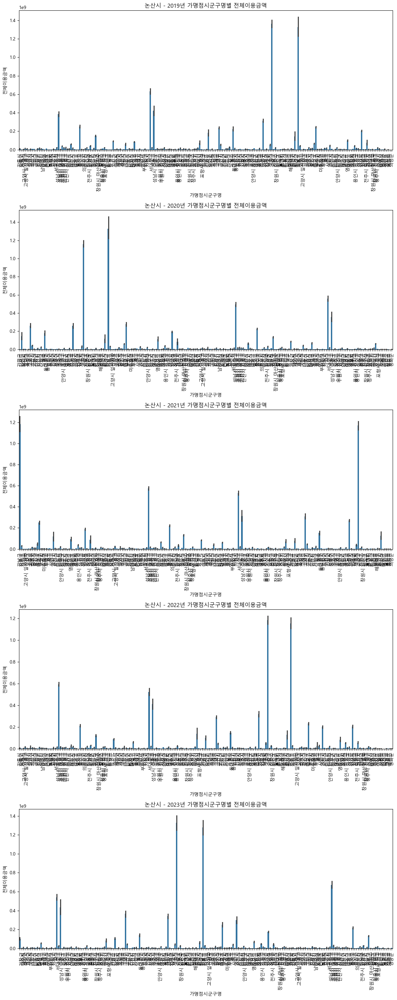

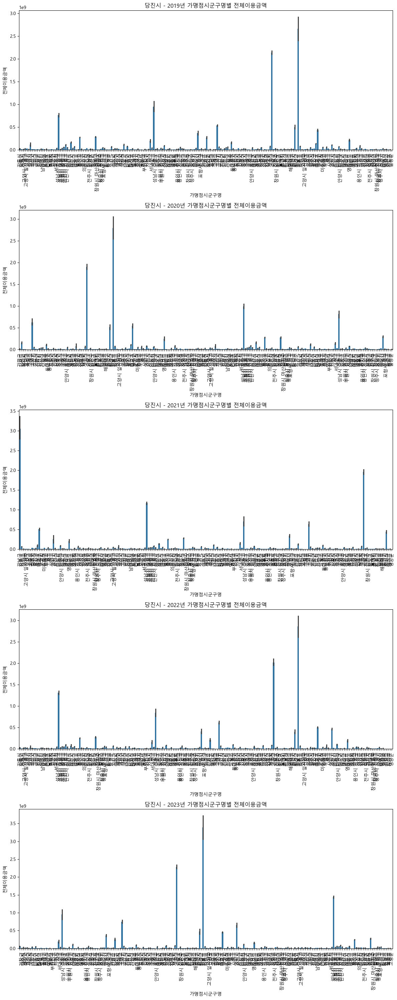

...

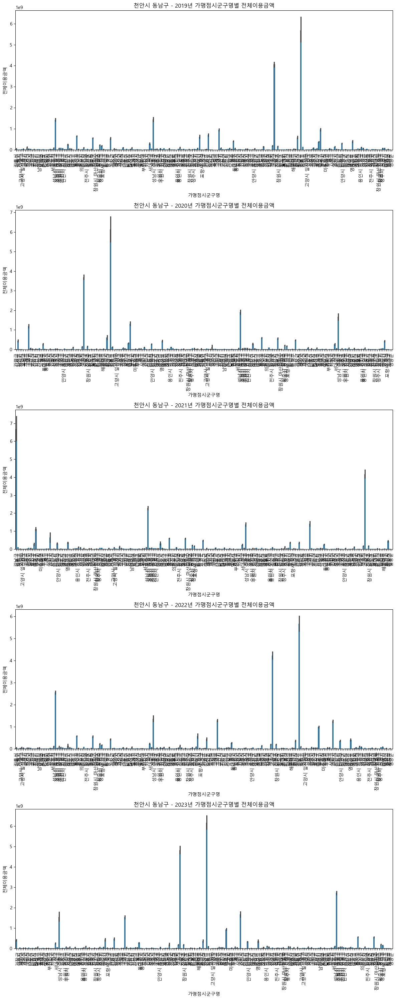

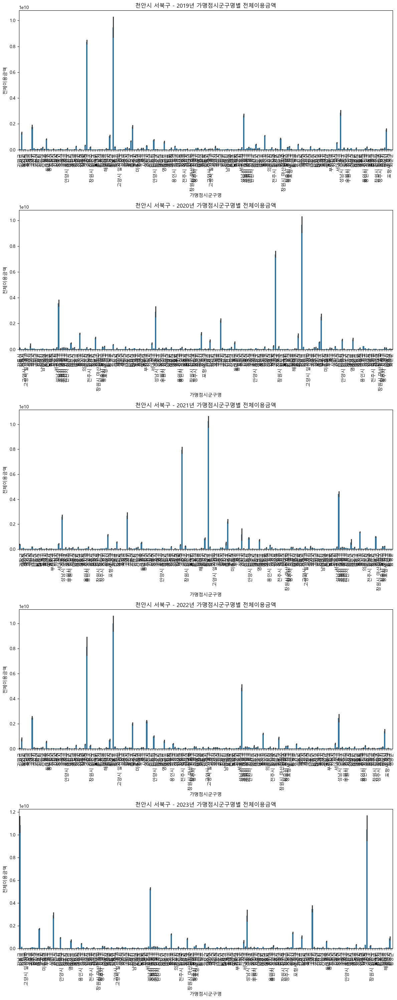

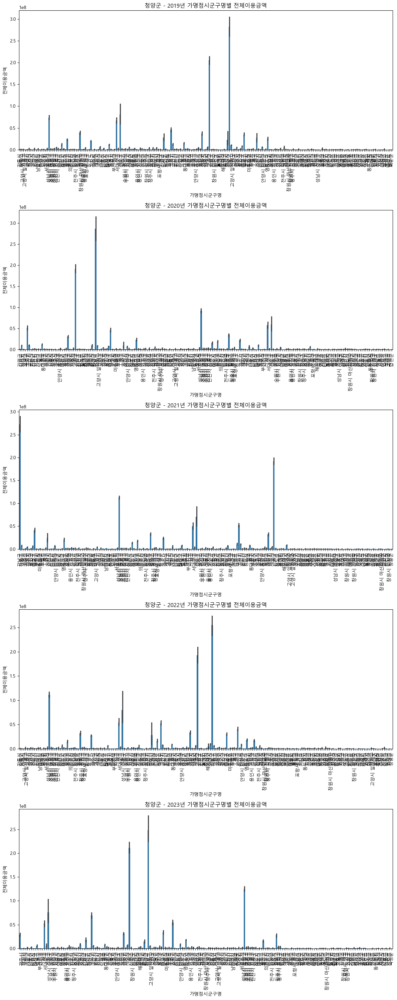

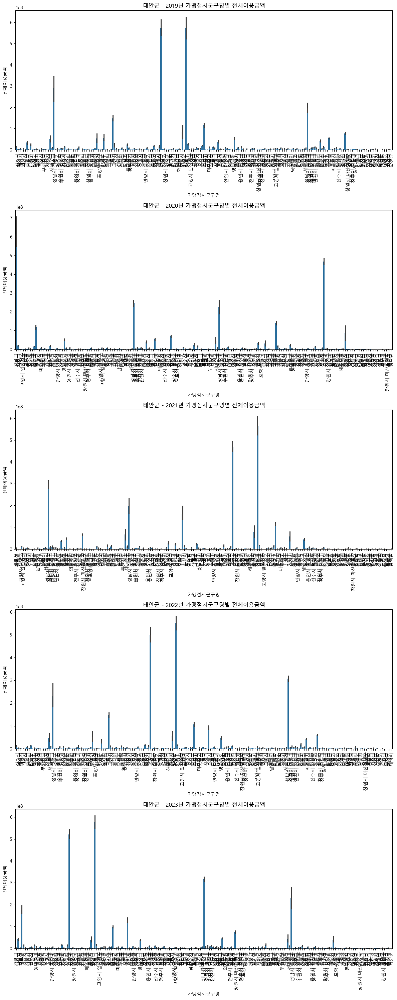

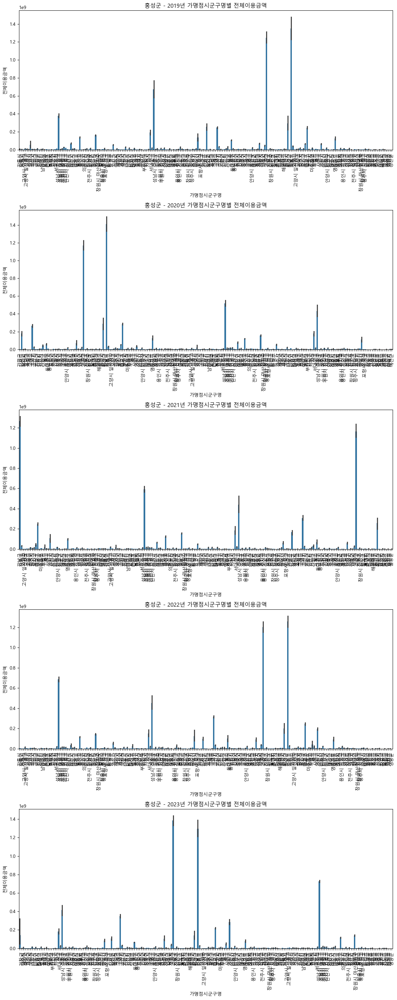

In [47]:
import seaborn as sns

# '기준연월'을 문자열로 변환
df_card_2['기준연월'] = df_card_2['기준연월'].astype(str)

# '기준연월'에서 연도 추출
df_card_2['년도'] = df_card_2['기준연월'].str[:4]

# 시군구명 리스트 추출
unique_regions = df_card_2['시군구명'].unique()

# 시군구별로 시각화
for region in unique_regions:
    df_region = df_card_2[df_card_2['시군구명'] == region]
    unique_years = df_region['년도'].unique()
    
    # 연도별로 그래프 생성
    fig, axs = plt.subplots(len(unique_years), 1, figsize=(12, len(unique_years) * 6))
    
    for i, year in enumerate(unique_years):
        df_year = df_region[df_region['년도'] == year]
        
        sns.barplot(data=df_year, x='가맹점시군구명', y='전체이용금액', ax=axs[i])
        
        axs[i].set_title(f'{region} - {year}년 가맹점시군구명별 전체이용금액')
        axs[i].set_xlabel('가맹점시군구명')
        axs[i].set_ylabel('전체이용금액')
        axs[i].tick_params(axis='x', rotation=90)
        
    plt.tight_layout()
    plt.show()

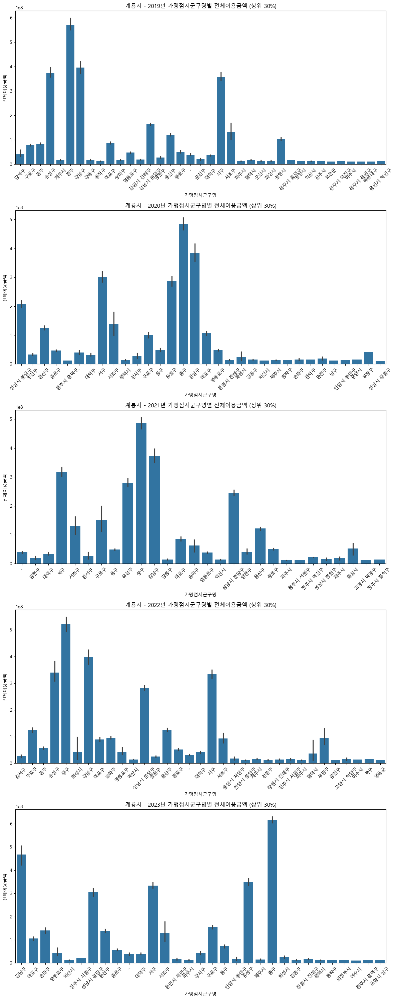

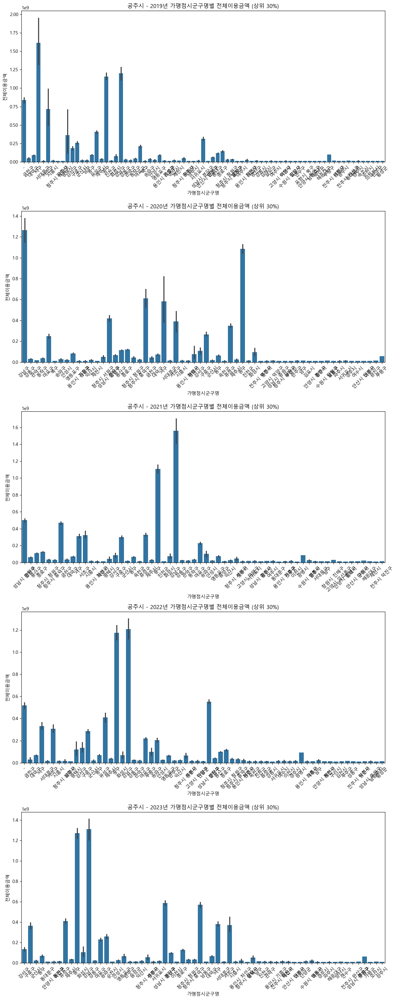

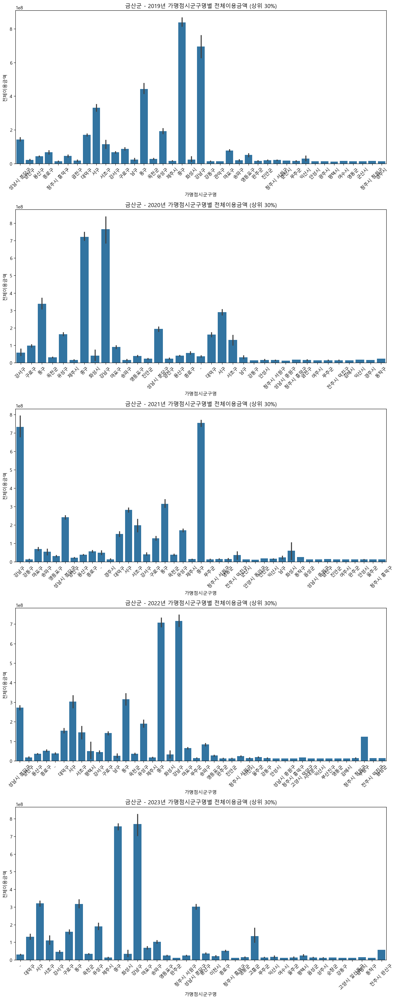

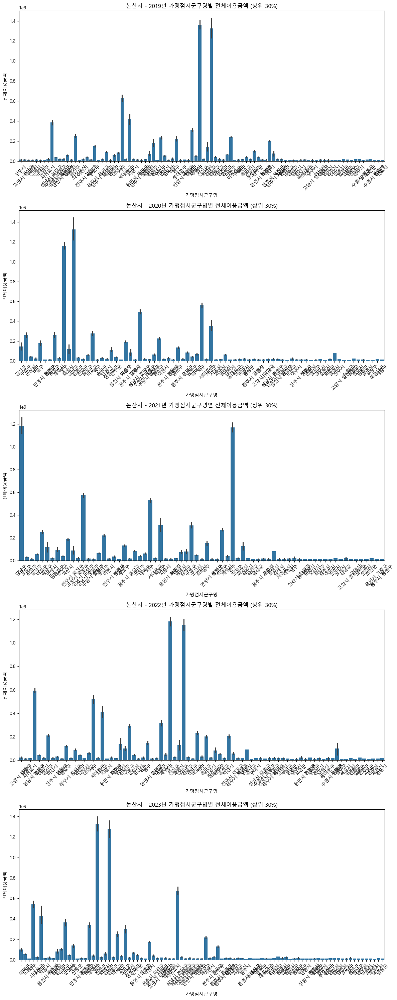

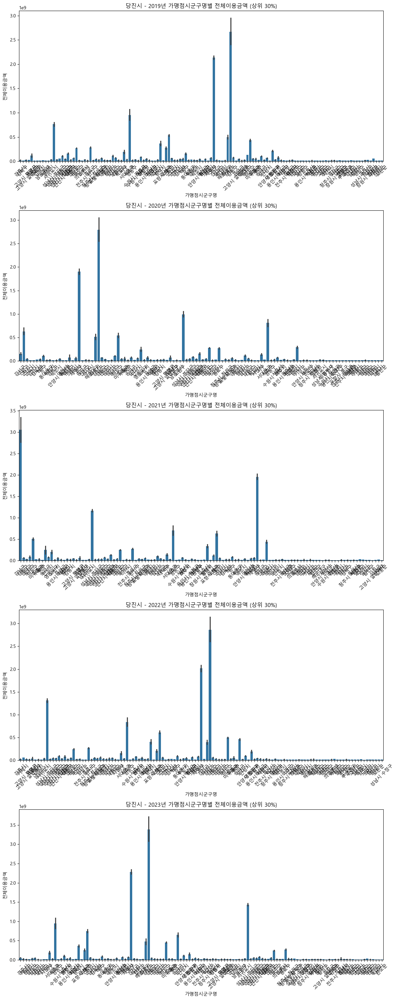

...

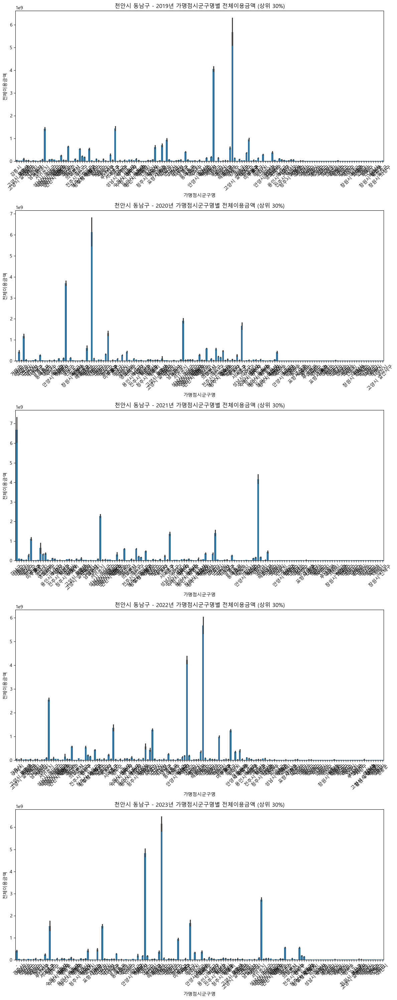

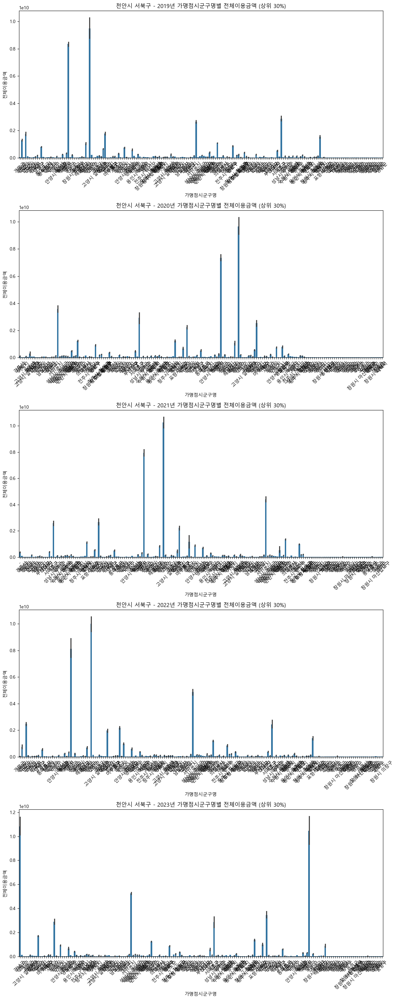

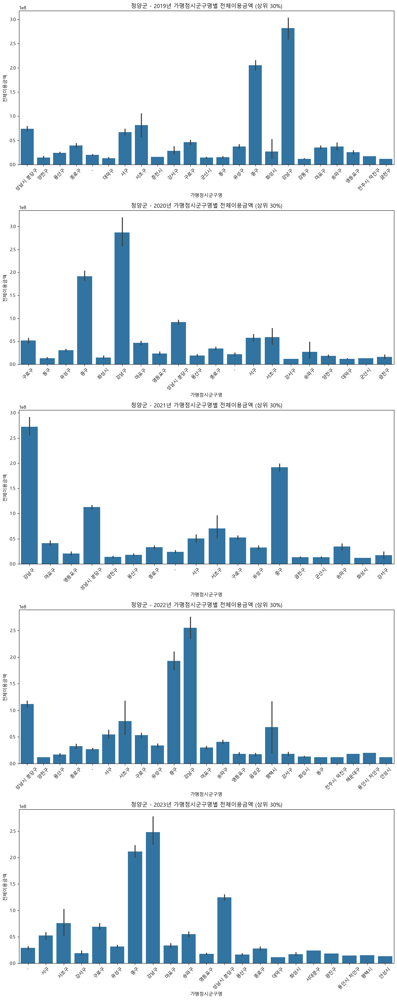

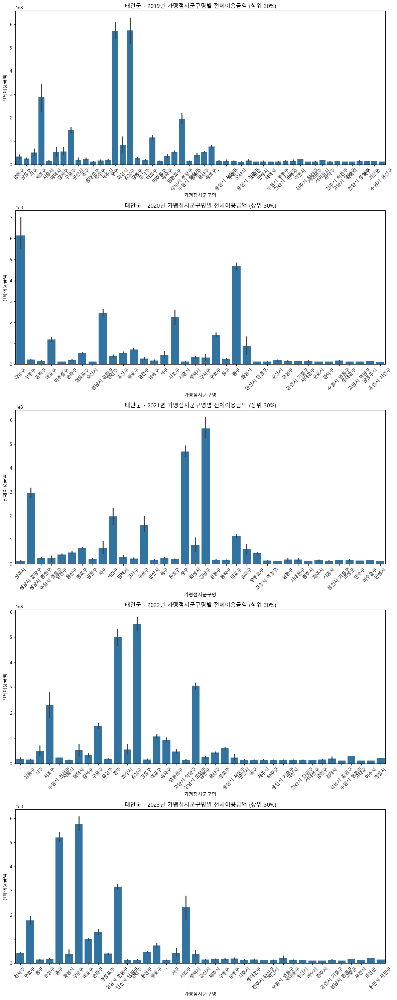

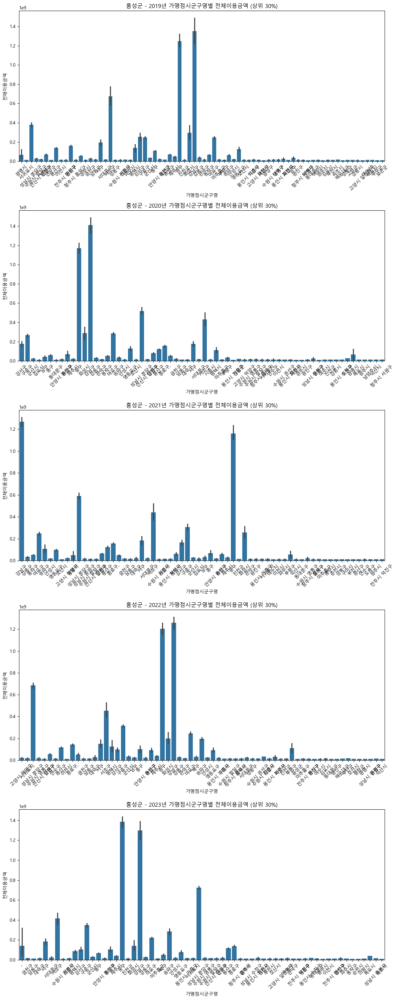

In [53]:
# '기준연월'을 문자열로 변환
df_card_2['기준연월'] = df_card_2['기준연월'].astype(str)

# '기준연월'에서 연도 추출
df_card_2['년도'] = df_card_2['기준연월'].str[:4]

# 전체이용금액 기준 상위 50% 필터링
threshold = df_card_2['전체이용금액'].quantile(0.7)
df_top50 = df_card_2[df_card_2['전체이용금액'] > threshold]

# 시군구명 리스트 추출
unique_regions = df_top50['시군구명'].unique()

# 시군구별로 시각화
for region in unique_regions:
    df_region = df_top50[df_top50['시군구명'] == region]
    unique_years = df_region['년도'].unique()
    
    # 연도별로 그래프 생성
    fig, axs = plt.subplots(len(unique_years), 1, figsize=(12, len(unique_years) * 6))
    
    for i, year in enumerate(unique_years):
        df_year = df_region[df_region['년도'] == year]
        
        sns.barplot(data=df_year, x='가맹점시군구명', y='전체이용금액', ax=axs[i])
        
        axs[i].set_title(f'{region} - {year}년 가맹점시군구명별 전체이용금액 (상위 30%)')
        axs[i].set_xlabel('가맹점시군구명')
        axs[i].set_ylabel('전체이용금액')
        axs[i].tick_params(axis='x', rotation=45)
        
    plt.tight_layout()
    plt.show()

충남외 고객기준 충남 소비 현황(BC카드자료기준)

In [9]:
df_card_3

,기준연월,고객광역시군구명,전체이용건수,전체이용금액
0,201901,세종특별자치시,85264,3098865139
1,201901,울산광역시,27791,991509656
2,201901,인천광역시,164820,5082848771
3,201901,전라북도,117489,3624541132
4,201901,충청북도,111399,3632282615
...,...,...,...,...
923,202309,경상남도,91351,2693089015
924,202309,광주광역시,48221,1437717086
925,202309,대전광역시,254604,8962126502
926,202310,경기도,1305701,41942230752


In [27]:
# 고객광역시군구명별로 그룹화
grouped = df_card_3.groupby('고객광역시군구명').sum().reset_index()
grouped

,고객광역시군구명,기준연월,전체이용건수,전체이용금액
0,강원도,10912533,1649522,45605299912
1,강원특별자치도,809234,133032,3665346310
2,경기도,11721767,67557143,2064439150203
3,경상남도,11721767,5082728,150305621706
4,경상북도,11721767,4057101,122875737094
5,광주광역시,11721767,2612434,77578604602
6,대구광역시,11721767,3607851,109258152248
7,대전광역시,11721767,14203738,495251308513
8,부산광역시,11721767,4758602,148938055310
9,서울특별시,11721767,36286310,1203494114139


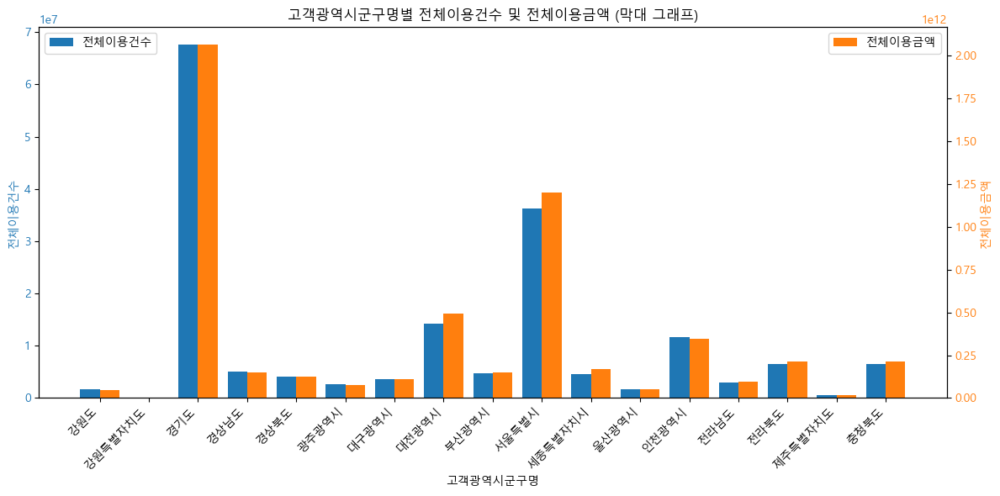

In [28]:
# 막대 그래프 시각화
fig, ax1 = plt.subplots(figsize=(12, 6))

# x축 설정
x = np.arange(len(grouped['고객광역시군구명']))

# 첫 번째 y축 (전체이용건수) 막대 그래프
color = 'tab:blue'
ax1.set_xlabel('고객광역시군구명')
ax1.set_ylabel('전체이용건수', color=color)
bars1 = ax1.bar(x - 0.2, grouped['전체이용건수'], width=0.4, color=color, label='전체이용건수')
ax1.tick_params(axis='y', labelcolor=color)

# 두 번째 y축 (전체이용금액) 막대 그래프
ax2 = ax1.twinx()
color = 'tab:orange'
ax2.set_ylabel('전체이용금액', color=color)
bars2 = ax2.bar(x + 0.2, grouped['전체이용금액'], width=0.4, color=color, label='전체이용금액')
ax2.tick_params(axis='y', labelcolor=color)

# x축 레이블 설정
ax1.set_xticks(x)
ax1.set_xticklabels(grouped['고객광역시군구명'], rotation=45, ha='right')

# 그래프 제목 및 레이아웃 설정
plt.title('고객광역시군구명별 전체이용건수 및 전체이용금액 (막대 그래프)')
fig.tight_layout()

# 범례 추가
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()

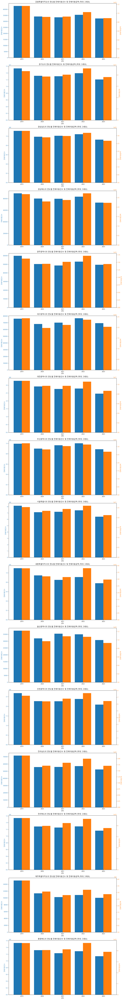

In [33]:
# '기준연월'을 문자열로 변환
df_card_3['기준연월'] = df_card_3['기준연월'].astype(str)

# '기준연월'에서 연도 추출
df_card_3['년도'] = df_card_3['기준연월'].str[:4]

# '강원도'와 '강원특별자치도'를 동일한 이름으로 통일 (예: '강원도')
df_card_3['고객광역시군구명'] = df_card_3['고객광역시군구명'].replace({'강원도': '강원특별자치도'})

# 연도와 고객광역시군구명별로 데이터 그룹화
grouped = df_card_3.groupby(['년도', '고객광역시군구명']).sum().reset_index()

# 모든 고객광역시군구명에 대해 반복하면서 시각화
unique_regions = grouped['고객광역시군구명'].unique()
num_regions = len(unique_regions)

# 전체 그래프 설정
fig, axs = plt.subplots(num_regions, 1, figsize=(12, num_regions * 6))

for i, region_name in enumerate(unique_regions):
    df_region = grouped[grouped['고객광역시군구명'] == region_name]

    # x축 설정
    x = np.arange(len(df_region['년도']))

    # 첫 번째 y축 (전체이용건수) 막대 그래프
    color = 'tab:blue'
    axs[i].set_xlabel('년도')
    axs[i].set_ylabel('전체이용건수', color=color)
    bars1 = axs[i].bar(x - 0.2, df_region['전체이용건수'], width=0.4, color=color, label='전체이용건수')
    axs[i].tick_params(axis='y', labelcolor=color)

    # 두 번째 y축 (전체이용금액) 막대 그래프
    ax2 = axs[i].twinx()
    color = 'tab:orange'
    ax2.set_ylabel('전체이용금액', color=color)
    bars2 = ax2.bar(x + 0.2, df_region['전체이용금액'], width=0.4, color=color, label='전체이용금액')
    ax2.tick_params(axis='y', labelcolor=color)

    # x축 레이블 설정
    axs[i].set_xticks(x)
    axs[i].set_xticklabels(df_region['년도'])

    # 그래프 제목 및 레이아웃 설정
    axs[i].set_title(f'{region_name}의 연도별 전체이용건수 및 전체이용금액 (막대 그래프)')

fig.tight_layout()
plt.show()

충남 월별 카드 소비 현황(BC카드자료기준)

In [10]:
df_card_4

,기준연월,시군구명,이용건수,이용금액
0,201901,계룡시,88154,2454073581
1,201901,금산군,145903,5210100942
2,201901,논산시,326570,13967662468
3,201901,당진시,636183,24238366473
4,201901,보령시,306387,12343364569
...,...,...,...,...
923,202310,예산군,284680,11945709414
924,202310,천안시 동남구,1224281,43713580942
925,202310,천안시 서북구,1670199,59921438247
926,202310,청양군,51999,2795141920


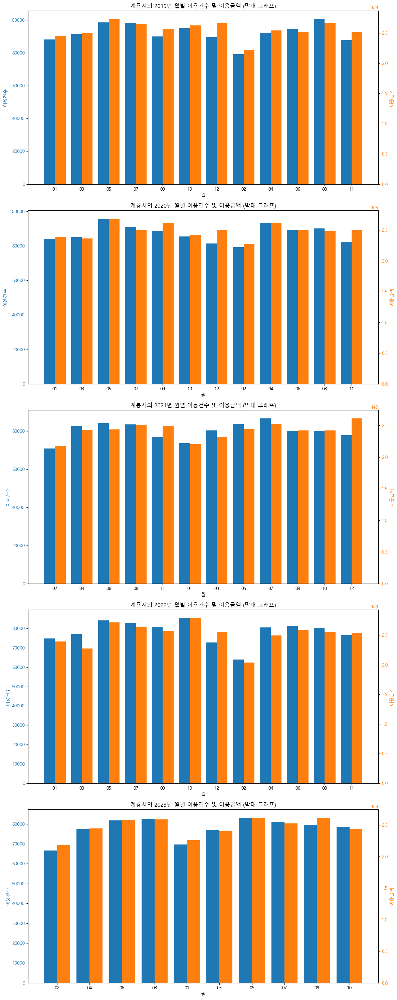

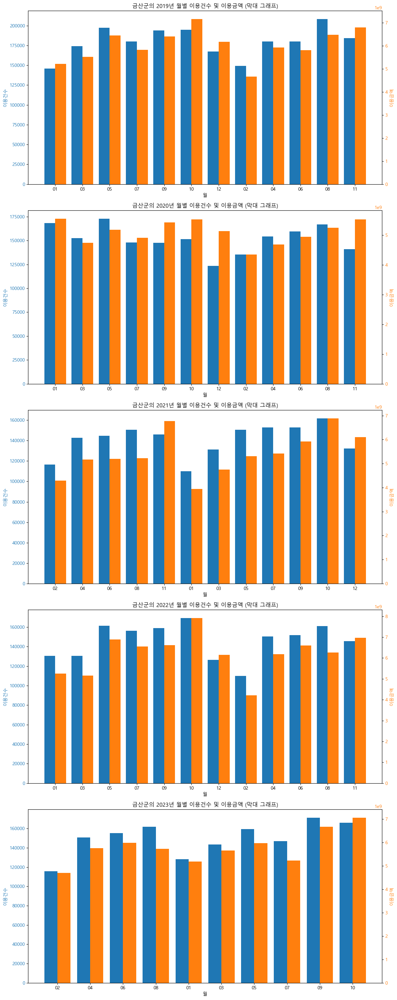

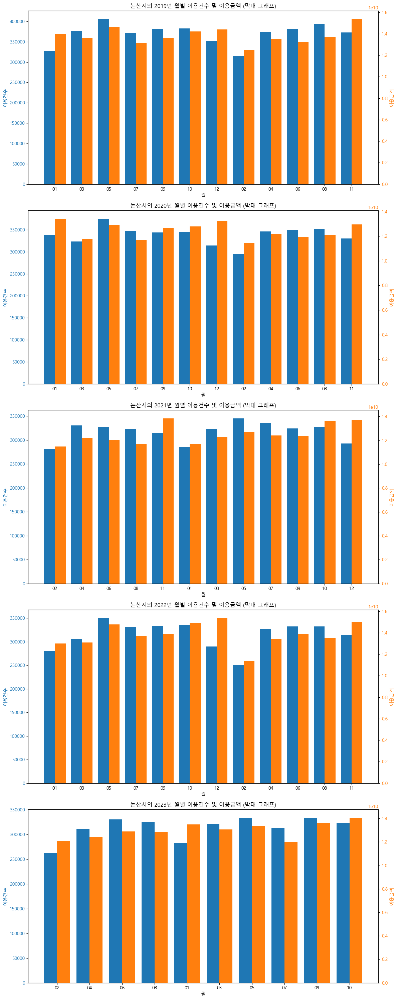

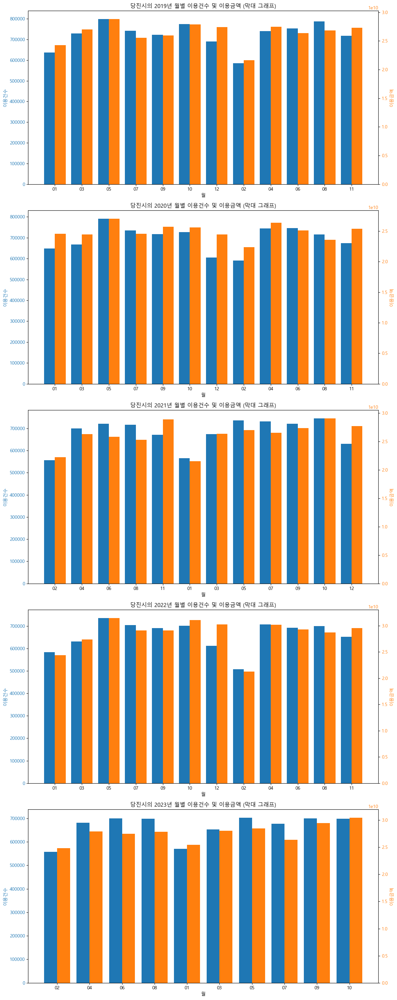

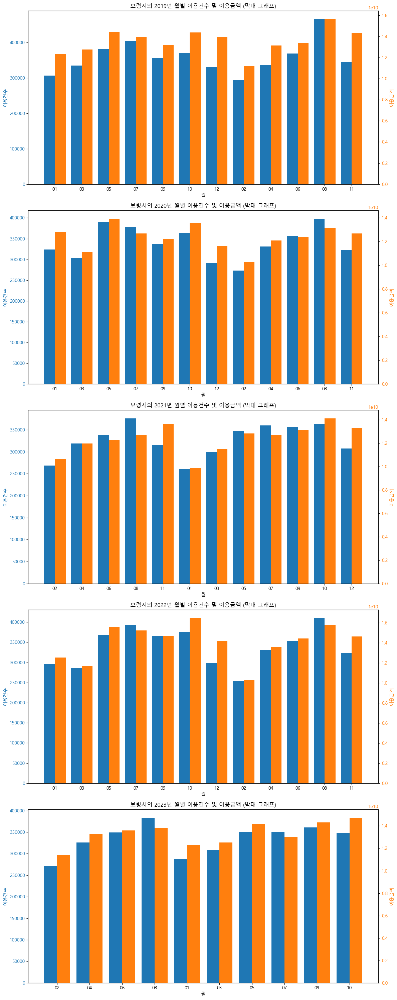

...

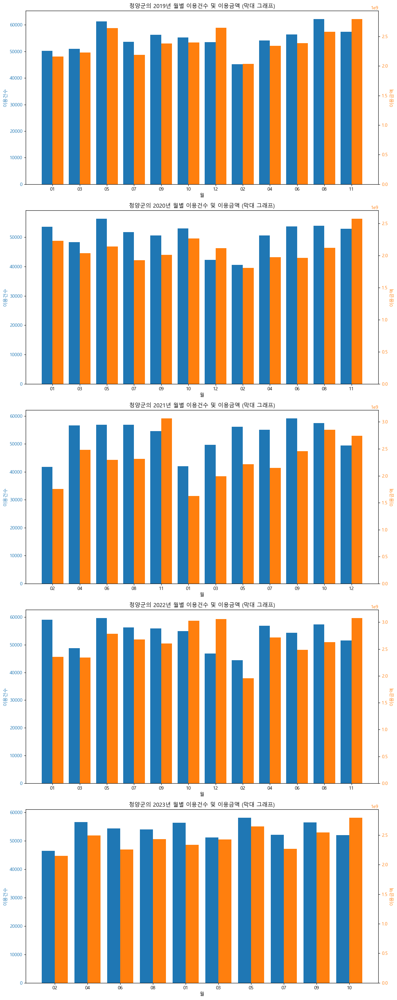

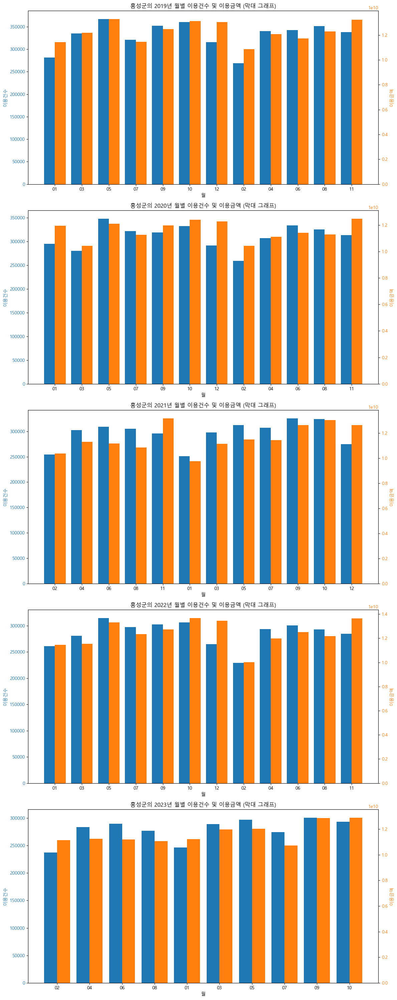

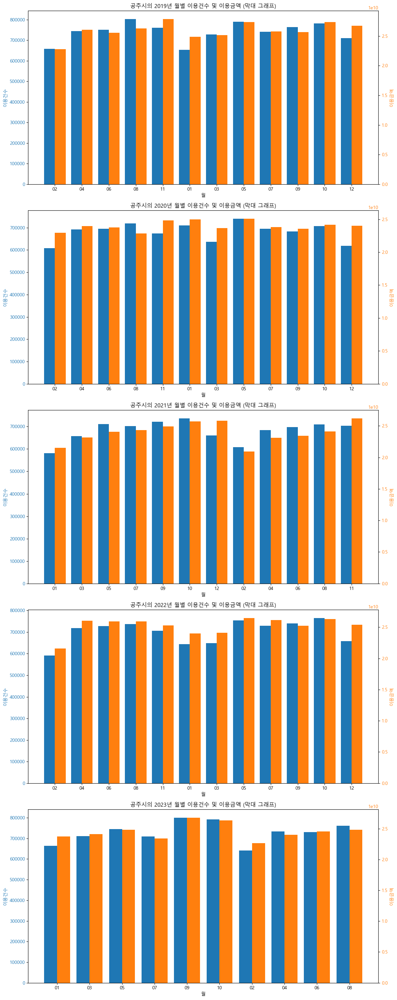

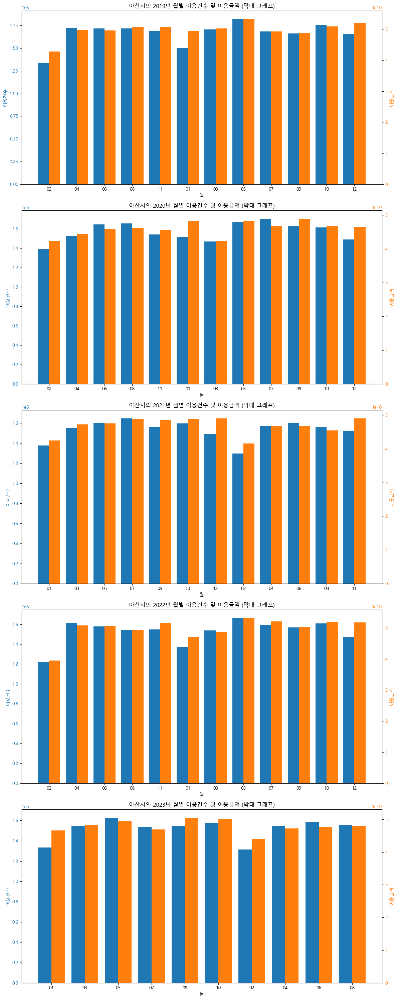

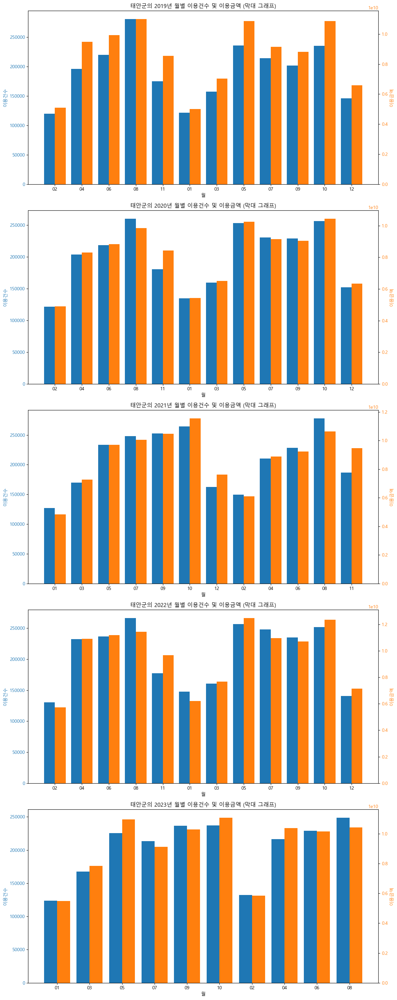

In [36]:
# '기준연월'을 문자열로 변환
df_card_4['기준연월'] = df_card_4['기준연월'].astype(str)

# '기준연월'에서 연도와 월을 추출
df_card_4['년도'] = df_card_4['기준연월'].str[:4]
df_card_4['월'] = df_card_4['기준연월'].str[4:6]

# 시군구명 리스트 추출
unique_regions = df_card_4['시군구명'].unique()

for region_name in unique_regions:
    df_region = df_card_4[df_card_4['시군구명'] == region_name]
    unique_years = df_region['년도'].unique()
    num_years = len(unique_years)

    # 전체 그래프 설정
    fig, axs = plt.subplots(num_years, 1, figsize=(12, num_years * 6))

    for i, year in enumerate(unique_years):
        df_year = df_region[df_region['년도'] == year]

        # x축 설정 (월별 데이터)
        x = np.arange(len(df_year['월']))

        # 첫 번째 y축 (이용건수) 막대 그래프
        color = 'tab:blue'
        axs[i].set_xlabel('월')
        axs[i].set_ylabel('이용건수', color=color)
        bars1 = axs[i].bar(x - 0.2, df_year['이용건수'], width=0.4, color=color, label='이용건수')
        axs[i].tick_params(axis='y', labelcolor=color)

        # 두 번째 y축 (이용금액) 막대 그래프
        ax2 = axs[i].twinx()
        color = 'tab:orange'
        ax2.set_ylabel('이용금액', color=color)
        bars2 = ax2.bar(x + 0.2, df_year['이용금액'], width=0.4, color=color, label='이용금액')
        ax2.tick_params(axis='y', labelcolor=color)

        # x축 레이블 설정
        axs[i].set_xticks(x)
        axs[i].set_xticklabels(df_year['월'])

        # 그래프 제목 및 레이아웃 설정
        axs[i].set_title(f'{region_name}의 {year}년 월별 이용건수 및 이용금액 (막대 그래프)')

    fig.tight_layout()
    plt.show()

In [39]:
df_pet_registration = pd.read_csv(f"{DATA_PATH}/반려동물 등록현황(2018~2023).csv", encoding = 'cp949')

In [40]:
df_pet_registration

,시군구,등록주체_시군구,등록주체_대행업체,등록주체_기타(이벤트등),RFID종류_내장형,RFID종류_외장형,RFID종류_인식표,등록품종수,동물소유자수,동물소유자당동물등록수,합계,미승인,반려
0,천안시,3478,29687,0,15024,13439,4702,154,25181,1.32,33165,0,35
1,공주시,320,3558,0,2342,1093,443,98,2756,1.41,3878,0,6
2,보령시,59,3773,0,1395,1587,850,104,2791,1.37,3832,0,2
3,아산시,1390,18012,0,9003,8471,1928,141,12661,1.53,19402,0,8
4,서산시,1123,6701,0,3228,3583,1013,116,5715,1.37,7824,0,2
5,논산시,196,4662,0,2637,1378,843,101,3360,1.45,4858,0,10
6,금산군,102,1805,0,939,409,559,78,1275,1.50,1907,0,3
7,부여군,98,2605,0,1607,786,310,75,1862,1.45,2703,0,0
8,서천군,91,1346,0,752,633,52,75,1058,1.36,1437,0,1
9,청양군,126,790,0,533,272,111,66,637,1.44,916,0,0


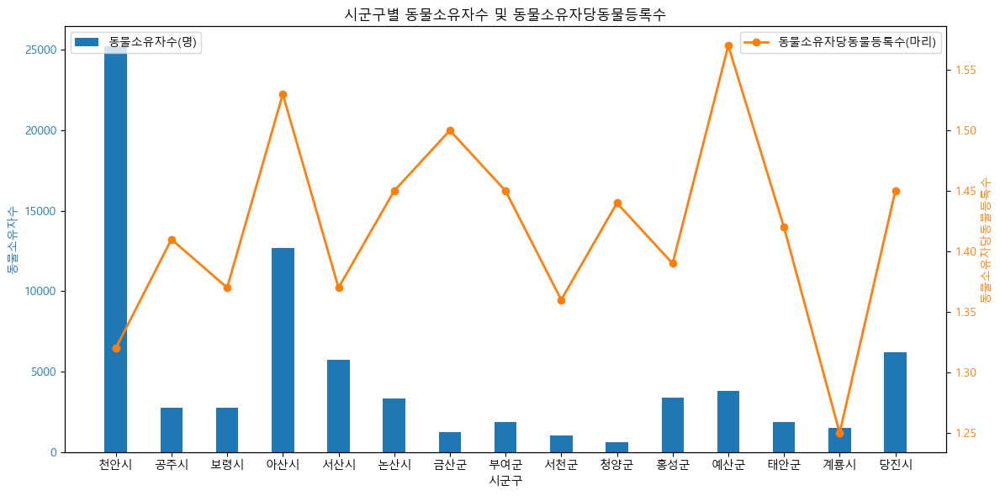

In [43]:
# x축 위치 설정
x = range(len(df_pet_registration['시군구']))

# 그래프 설정
fig, ax1 = plt.subplots(figsize=(12, 6))

# 첫 번째 y축 (동물소유자수) 막대 그래프
color = 'tab:blue'
ax1.set_xlabel('시군구')
ax1.set_ylabel('동물소유자수', color=color)
bars1 = ax1.bar(x, df_pet_registration['동물소유자수'], color=color, width=0.4, label='동물소유자수(명)')
ax1.tick_params(axis='y', labelcolor=color)

# 두 번째 y축 (동물소유자당동물등록수) 선 그래프
ax2 = ax1.twinx()
color = 'tab:orange'
ax2.set_ylabel('동물소유자당동물등록수', color=color)
line2 = ax2.plot(x, df_pet_registration['동물소유자당동물등록수'], color=color, marker='o', linestyle='-', linewidth=2, label='동물소유자당동물등록수(마리)')
ax2.tick_params(axis='y', labelcolor=color)

# x축 레이블 설정
ax1.set_xticks(x)
ax1.set_xticklabels(df_pet_registration['시군구'])

# 그래프 제목 및 레이아웃 설정
plt.title('시군구별 동물소유자수 및 동물소유자당동물등록수')
fig.tight_layout()

# 범례 추가
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()